In [1]:
%load_ext autoreload
%autoreload 2
%load_ext tensorboard

In [2]:
import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3' 

In [3]:
import numpy as np
import pickle
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import time
import json
import pprint

from PIL import Image
from IPython.display import display

import tensorflow as tf
from tensorflow.keras import layers, models

from build_model_ed import build_model_1, build_model_2, build_model_3
from build_model_lstm import build_model_lstm_1, build_model_lstm_2, build_model_lstm_3
from get_frames import get_frames
from get_encoder_decoder import get_encoder_decoder
from get_errors import get_ssim, get_mse, get_errors
from assemble_image import assemble_image
from load_models import load_encoder_decoder_model, load_lstm_model, load_classification_model, load_models
from prediction import predict_step, predict_image, plot_prediction, plot_probabilities, plot_probabilities_2, plot_prediction_single, plot_prediction_single_2
from get_labels import get_labels, get_defect_label
from load_image import load_image

In [4]:
#gpu check
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))

Num GPUs Available:  1


In [41]:
#load data image list
test_size = 0.1
stride_step = 50
norm_factor=1
dtype = 'uint8'

filename = f'save_data/e_d_test_all_str_50_ts_{test_size}_{dtype}_norm_{norm_factor}.pkl'
#load data
with open(filename, 'rb') as f:
    image_list,frames_data = pickle.load(f)
    
del frames_data

#image list
print('Image list:')
print('\n'.join([f'{i}: {image}' for i, image in enumerate(image_list)]))

#load labels
file_name = f'defects_borders.json'
folder = f'save_data/classify_data'  

with open(f'{folder}/{file_name}', 'r') as f:
    borders_dict = json.load(f)
    
defect_type_dict = {
    0:'No defect',
    1:'Twist',
    2:'Puck',
    3:'Fold'
    }

Image list:
0: Fold21.png
1: Pucker3.png
2: Fold3.png
3: Pucker23.png
4: Pucker16.png
5: Twist31.png
6: Pucker7.png
7: Pucker26.png
8: Pucker24.png


In [6]:
stride_step_list = [50,100,160,200]
unit_numb_list = [5,10,20,30]
unit_numb_list = [5,30]
#unit_numb_list = [30,]
stateful_list = [False]
sliding_window_settings_dict = {
    stride_step_list[0]:[(6,1,0),(6,6,3)],
    stride_step_list[1]:[(6,1,0),(6,6,3),(4,1,0),(4,4,2)],
    stride_step_list[2]:[(6,1,0),(6,6,3),(4,1,0),(4,4,2)],
    stride_step_list[3]:[(6,1,0),(6,6,3),(4,1,0),(4,4,2),(2,1,0),(2,2,1)],    
}

Image shape: (2048, 4000, 3)


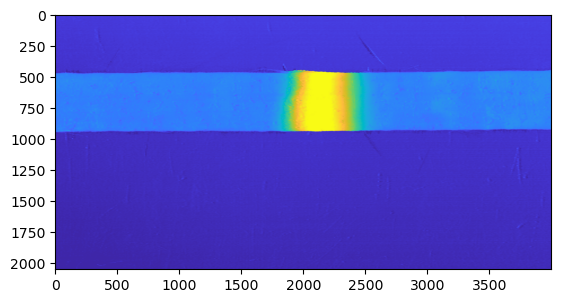

In [53]:
#choose image
#pucker to plot
test_case = image_list[7]
test_case = 'Pucker13.png'
image_data_gt = load_image(test_case)
print(f'Image shape: {image_data_gt.shape}')
plt.imshow(image_data_gt)

In [54]:
#stride 50, frames_to_pred_total = 68
#stride 100, frames_to_pred_total = 34

#load models
stride_step = stride_step_list[0]
window_size, window_size_predicted, overlap = sliding_window_settings_dict[stride_step][0]
lstm_type = 'win'
stateful = False
#how many frames to predict within a single step
repeat_prediction = 6
#how many steps
frames_to_pred_total = 68
#load classifier model
classifier=True
verbose = 0
print(f'Stride: {stride_step}; predict: {window_size, window_size_predicted, overlap}; repeat_prediction: {repeat_prediction}; stateful: {stateful}')

borders_list = borders_dict[test_case]
image_length = image_data_gt.shape[1]
defect_type = get_defect_label(test_case)
predicted_data_dict = {}
labels_dict = {}

lstm_pars_dict = {
    'stateful':stateful,
    'window_size':window_size,
    'window_size_predicted':window_size_predicted,
    'overlap':overlap,
    'lstm_type':lstm_type,
}

#get ground truth frames
image_data_frames_gt = get_frames(image_data_gt, stride_step, ifPrint = False)
#get ground truth labels
window_size_total = window_size + (window_size_predicted-overlap)*repeat_prediction
labels_gt = get_labels(
    stride_step,
    borders_list, 
    image_length, 
    window_size_total//2, 
    #window_size_total,
    defect_type
)[:frames_to_pred_total]
labels_dict['gt'] = labels_gt

plot_settings_dict = {
    'labels_dict':labels_dict,
    'ifMetrics':True,
    'ifSave':True,
    'save_folder':f'pictures/paper_pictures/stride_{stride_step}/pucker13',
    'ifClose':True
}

for unit_numb in unit_numb_list:

    #load models
    models_dict = load_models(unit_numb, stride_step, lstm_pars_dict, classifier=classifier)
    
    image_data_frames_list, image_data_frames_encoded = predict_image(
        image_data_frames_gt, 
        models_dict,
        lstm_pars_dict, 
        repeat_prediction,
        verbose=verbose,
        frames_to_pred_total=frames_to_pred_total
    )
    predicted_data_dict[unit_numb] = image_data_frames_list
    
    #classify
    #probabilities of defects for each frame
    try:
        probabilities = models_dict['model_classifier'].predict(np.array(image_data_frames_encoded), verbose=0)
        labels_predicted = np.argmax(probabilities, axis=1)
        labels_dict[unit_numb] = [labels_predicted, probabilities]
    except KeyError:
        #if no classifier is available
        pass
       
plot_prediction_single_2(
    image_data_frames_gt,
    predicted_data_dict,
    lstm_pars_dict,
    repeat_prediction,
    plot_settings_dict,
)

Stride: 50; predict: (6, 1, 0); repeat_prediction: 6; stateful: False


(4,)


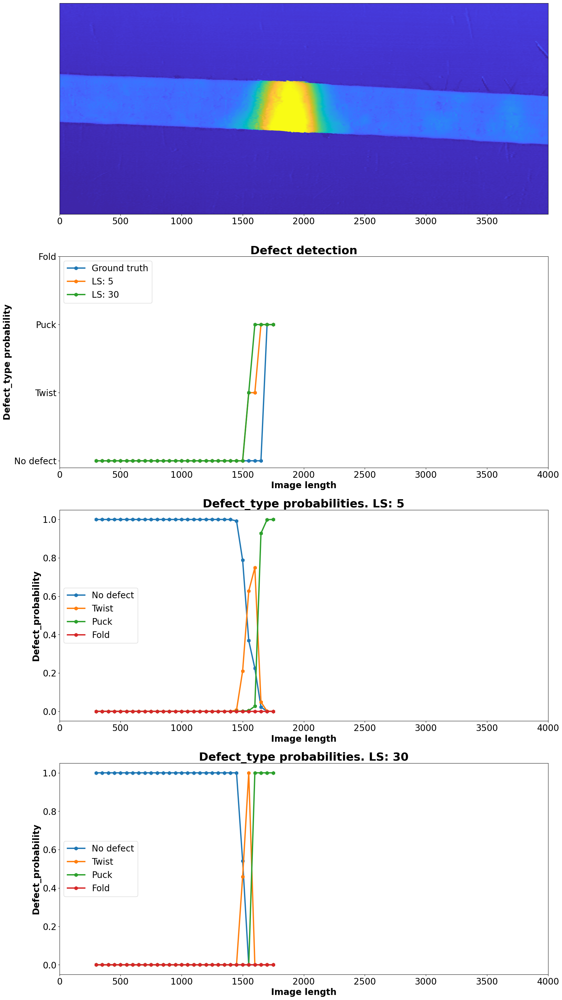

In [10]:
plot_probabilities_2(labels_dict, window_size_total/2, stride_step, test_case)

(4,)


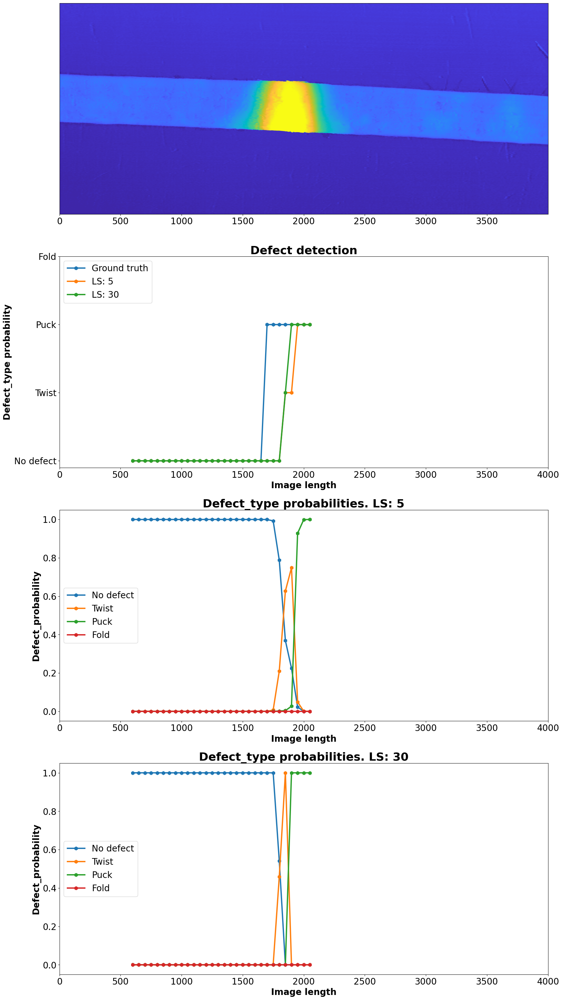

In [12]:
plot_probabilities_2(labels_dict, window_size_total, stride_step, test_case)

Image shape: (2048, 4000, 3)


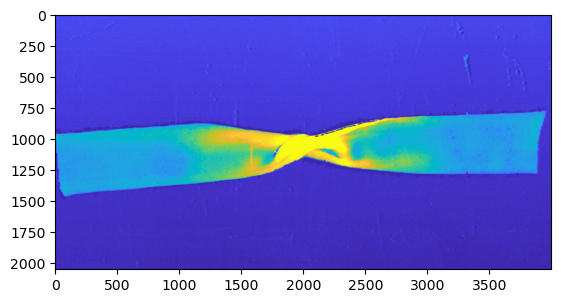

In [8]:
#choose image
test_case = 'Twist22.png'
image_data_gt = load_image(test_case)
print(f'Image shape: {image_data_gt.shape}')
plt.imshow(image_data_gt)

In [ ]:
#load models
stride_step = stride_step_list[0]
window_size, window_size_predicted, overlap = sliding_window_settings_dict[stride_step][0]
lstm_type = 'win'
stateful = False
repeat_prediction = 6
frames_to_pred_total = 60
verbose = 0
print(f'Stride: {stride_step}; predict: {window_size, window_size_predicted, overlap}; repeat_prediction: {repeat_prediction}; stateful: {stateful}')

borders_list = borders_dict[test_case]
image_length = image_data_gt.shape[1]
defect_type = get_defect_label(test_case)
predicted_data_dict = {}
labels_dict = {}

lstm_pars_dict = {
    'stateful':stateful,
    'window_size':window_size,
    'window_size_predicted':window_size_predicted,
    'overlap':overlap,
    'lstm_type':lstm_type,
}

#get ground truth frames
image_data_frames_gt = get_frames(image_data_gt, stride_step, ifPrint = False)
#get ground truth labels
window_size_total = window_size + (window_size_predicted-overlap)*repeat_prediction
labels_gt = get_labels(
    stride_step,
    borders_list, 
    image_length, 
    window_size_total, 
    defect_type
)[:frames_to_pred_total]
labels_dict['gt'] = labels_gt

plot_settings_dict = {
    'labels_dict':labels_dict,
    'ifMetrics':True,
    'ifSave':True,
    'save_folder':'pictures/twist_metrics'
}

for unit_numb in unit_numb_list:

    #load models
    models_dict = load_models(unit_numb, stride_step, lstm_pars_dict, classifier=True)
    
    image_data_frames_list, image_data_frames_encoded = predict_image(
        image_data_frames_gt, 
        models_dict,
        lstm_pars_dict, 
        repeat_prediction,
        verbose=verbose,
        frames_to_pred_total=frames_to_pred_total
    )
    predicted_data_dict[unit_numb] = image_data_frames_list
    
    #classify
    #probabilities of defects for each frame
    probabilities = models_dict['model_classifier'].predict(np.array(image_data_frames_encoded), verbose=0)
    labels_predicted = np.argmax(probabilities, axis=1)
    labels_dict[unit_numb] = [labels_predicted, probabilities]
       
plot_prediction_single(
    image_data_frames_gt,
    predicted_data_dict,
    lstm_pars_dict,
    repeat_prediction,
    plot_settings_dict,
)

(4,)


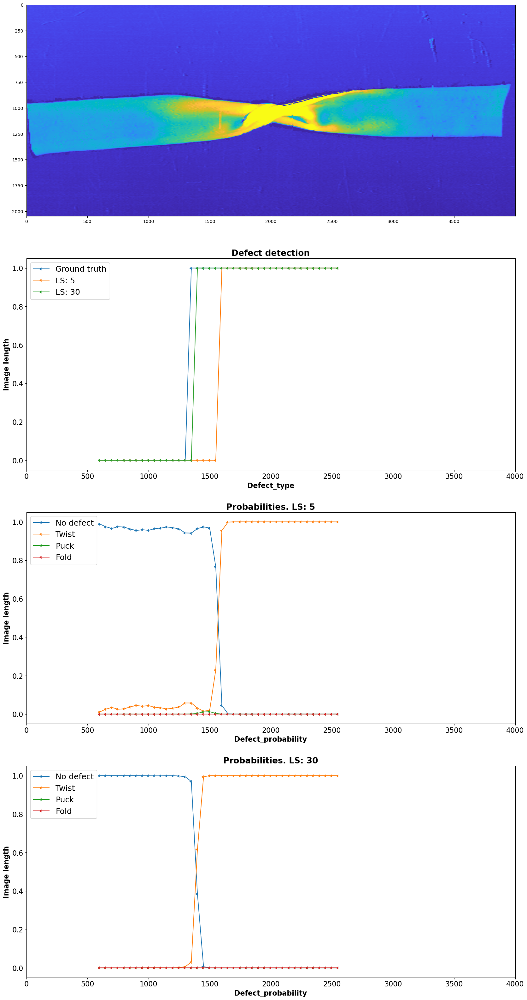

In [12]:
plot_probabilities(labels_dict, window_size_total, stride_step, test_case)

Image shape: (2048, 4000, 3)


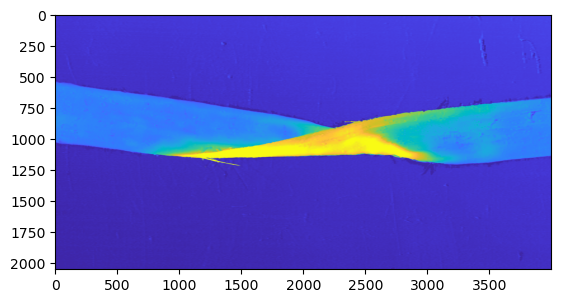

In [7]:
#choose image
test_case = 'Twist23.png'
image_data_gt = load_image(test_case)
print(f'Image shape: {image_data_gt.shape}')
plt.imshow(image_data_gt)

Stride: 50; predict: (6, 1, 0); repeat_prediction: 6; stateful: False


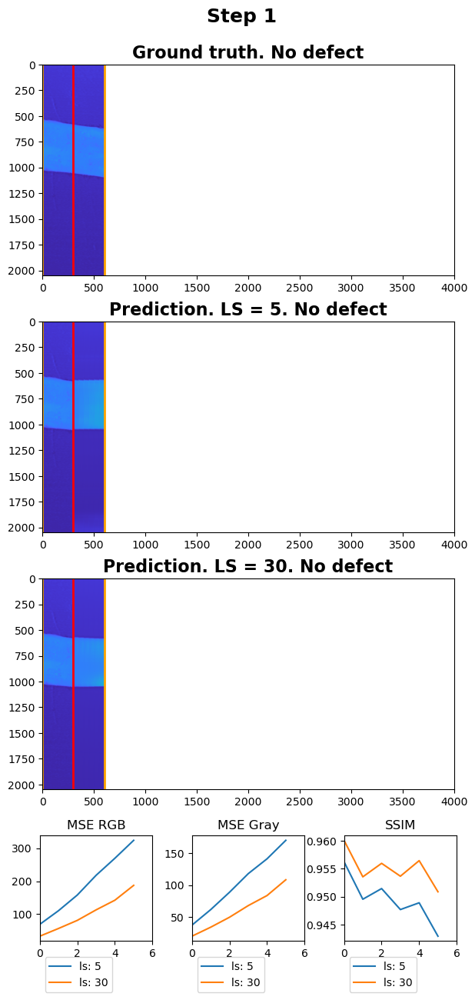

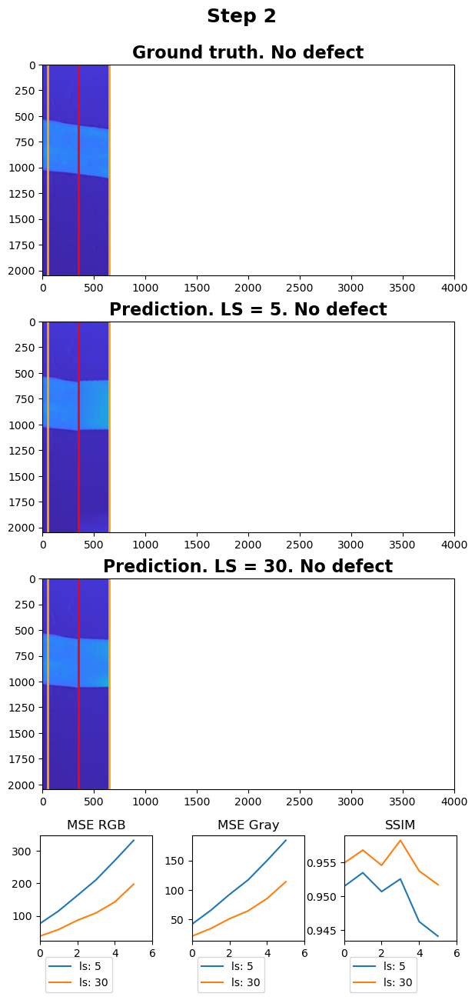

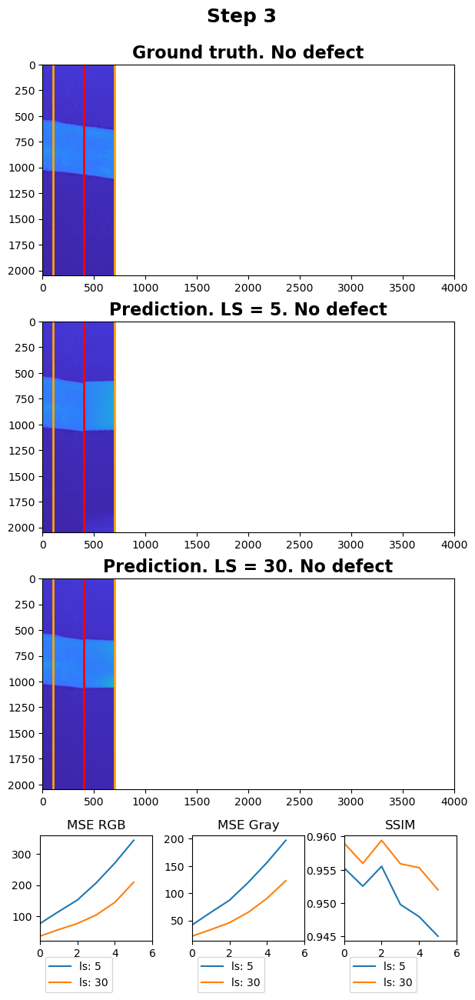

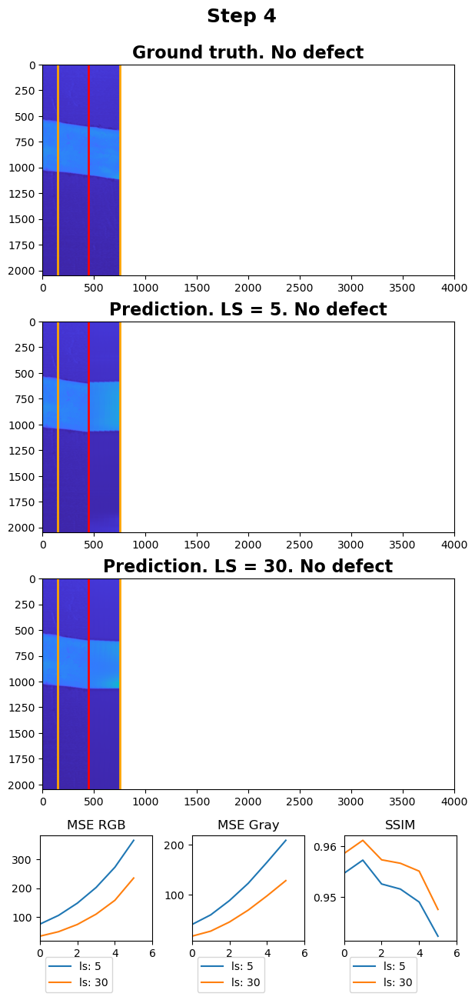

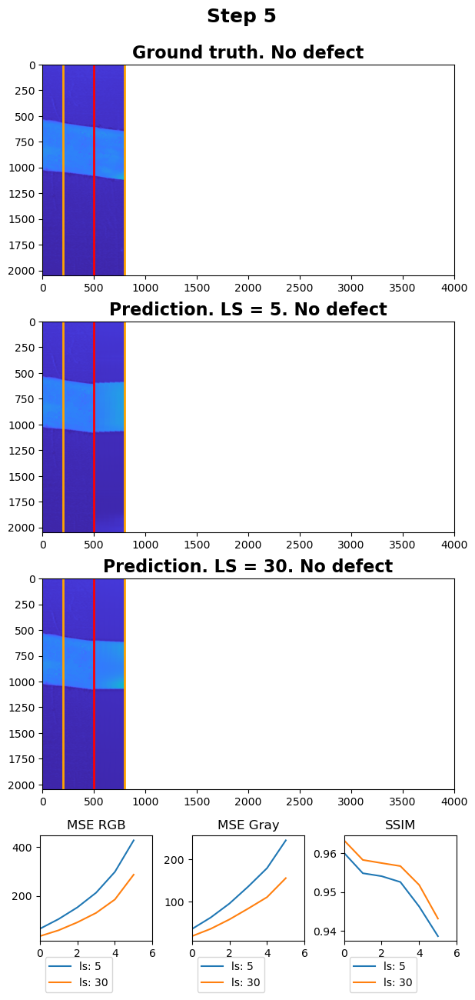

...

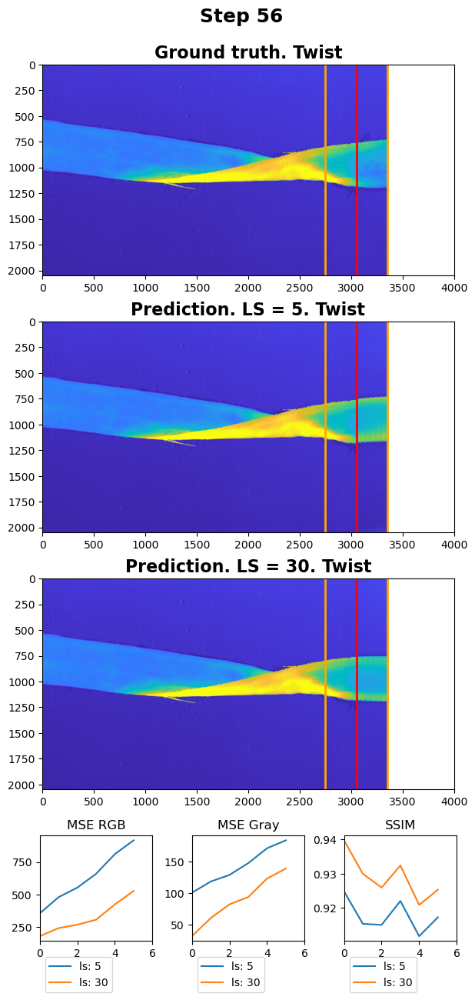

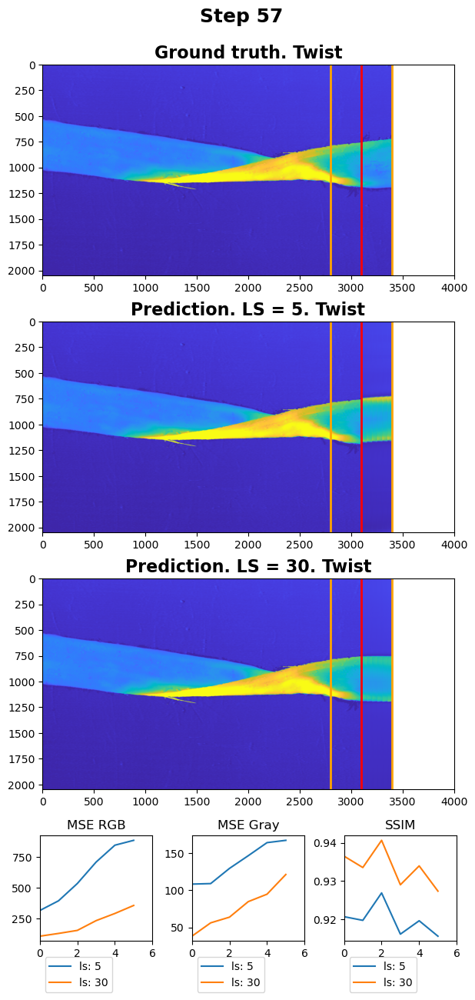

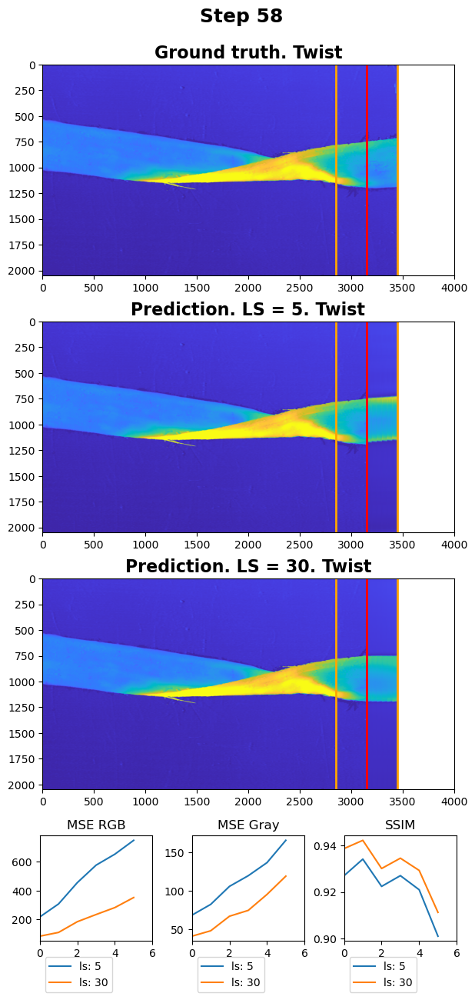

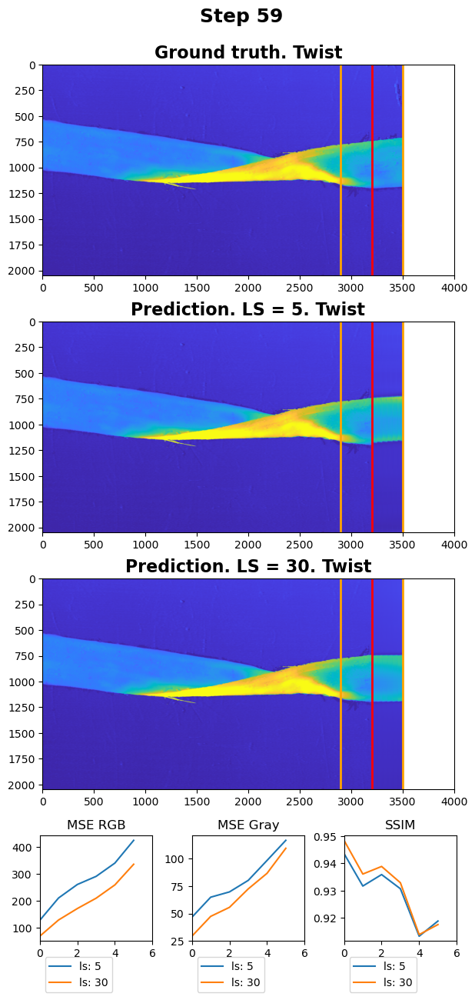

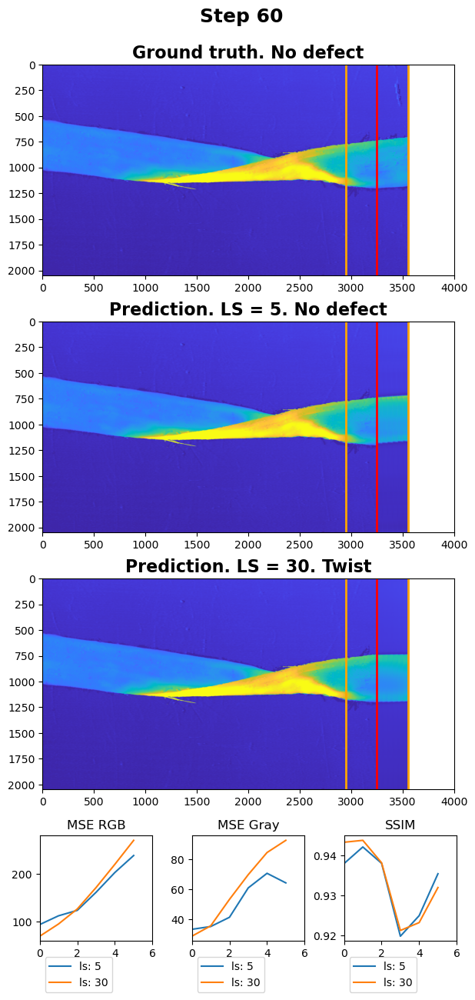

In [10]:
#load models
stride_step = stride_step_list[0]
window_size, window_size_predicted, overlap = sliding_window_settings_dict[stride_step][0]
lstm_type = 'win'
stateful = False
repeat_prediction = 6
frames_to_pred_total = 60
verbose = 0
print(f'Stride: {stride_step}; predict: {window_size, window_size_predicted, overlap}; repeat_prediction: {repeat_prediction}; stateful: {stateful}')

borders_list = borders_dict[test_case]
image_length = image_data_gt.shape[1]
defect_type = get_defect_label(test_case)
predicted_data_dict = {}
labels_dict = {}

lstm_pars_dict = {
    'stateful':stateful,
    'window_size':window_size,
    'window_size_predicted':window_size_predicted,
    'overlap':overlap,
    'lstm_type':lstm_type,
}

#get ground truth frames
image_data_frames_gt = get_frames(image_data_gt, stride_step, ifPrint = False)
#get ground truth labels
window_size_total = window_size + (window_size_predicted-overlap)*repeat_prediction
labels_gt = get_labels(
    stride_step,
    borders_list, 
    image_length, 
    #window_size_total,
    window_size_total//2,
    defect_type
)[:frames_to_pred_total]
labels_dict['gt'] = labels_gt


plot_settings_dict = {
    'labels_dict':labels_dict,
    'ifMetrics':True,
    'ifSave':True,
    'save_folder':f'pictures/paper_pictures/stride_{stride_step}/twist23',
    'ifClose':False
}

for unit_numb in unit_numb_list:

    #load models
    models_dict = load_models(unit_numb, stride_step, lstm_pars_dict, classifier=True)
    
    image_data_frames_list, image_data_frames_encoded = predict_image(
        image_data_frames_gt, 
        models_dict,
        lstm_pars_dict, 
        repeat_prediction,
        verbose=verbose,
        frames_to_pred_total=frames_to_pred_total
    )
    predicted_data_dict[unit_numb] = image_data_frames_list
    
    #classify
    #probabilities of defects for each frame
    probabilities = models_dict['model_classifier'].predict(np.array(image_data_frames_encoded), verbose=0)
    labels_predicted = np.argmax(probabilities, axis=1)
    labels_dict[unit_numb] = [labels_predicted, probabilities]
       
plot_prediction_single(
    image_data_frames_gt,
    predicted_data_dict,
    lstm_pars_dict,
    repeat_prediction,
    plot_settings_dict,
)

(4,)


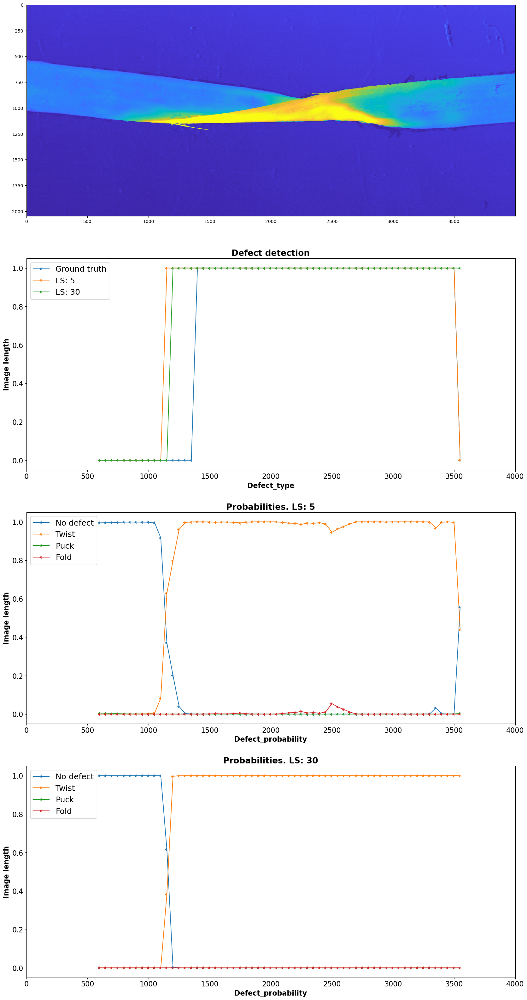

In [11]:
plot_probabilities(labels_dict, window_size_total, stride_step, test_case)

Image shape: (2048, 4000, 3)


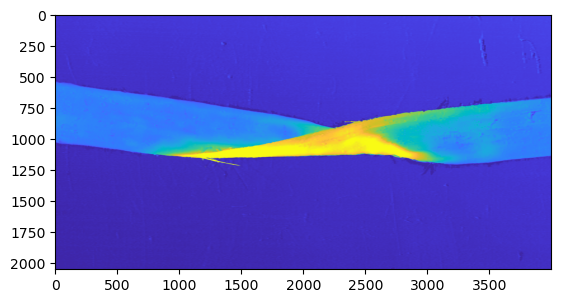

In [25]:
#choose image
test_case = 'Twist23.png'
image_data_gt = load_image(test_case)
print(f'Image shape: {image_data_gt.shape}')
plt.imshow(image_data_gt)

In [ ]:
#load models
stride_step = stride_step_list[0]
window_size, window_size_predicted, overlap = sliding_window_settings_dict[stride_step][0]
lstm_type = 'win'
stateful = False
repeat_prediction = 6
frames_to_pred_total = 40
verbose = 0
print(f'Stride: {stride_step}; predict: {window_size, window_size_predicted, overlap}; repeat_prediction: {repeat_prediction}; stateful: {stateful}')

borders_list = borders_dict[test_case]
image_length = image_data_gt.shape[1]
defect_type = get_defect_label(test_case)
predicted_data_dict = {}
labels_dict = {}

lstm_pars_dict = {
    'stateful':stateful,
    'window_size':window_size,
    'window_size_predicted':window_size_predicted,
    'overlap':overlap,
    'lstm_type':lstm_type,
}

#get ground truth frames
image_data_frames_gt = get_frames(image_data_gt, stride_step, ifPrint = False)
#get ground truth labels
window_size_total = window_size + (window_size_predicted-overlap)*repeat_prediction
labels_gt = get_labels(
    stride_step,
    borders_list, 
    image_length, 
    window_size_total, 
    defect_type
)[:frames_to_pred_total]
labels_dict['gt'] = labels_gt

for unit_numb in unit_numb_list:

    #load models
    models_dict = load_models(unit_numb, stride_step, lstm_pars_dict, classifier=True)
    
    image_data_frames_list, image_data_frames_encoded = predict_image(
        image_data_frames_gt, 
        models_dict,
        lstm_pars_dict, 
        repeat_prediction,
        verbose=verbose,
        frames_to_pred_total=frames_to_pred_total
    )
    predicted_data_dict[unit_numb] = image_data_frames_list
    
    #classify
    #probabilities of defects for each frame
    probabilities = models_dict['model_classifier'].predict(np.array(image_data_frames_encoded), verbose=0)
    labels_predicted = np.argmax(probabilities, axis=1)
    labels_dict[unit_numb] = [labels_predicted, probabilities]
       
plot_prediction(
    image_data_frames_gt,
    predicted_data_dict,
    lstm_pars_dict,
    repeat_prediction,
    labels_dict = labels_dict,
    numb_cols=3
)

In [ ]:
plot_probabilities_2

In [ ]:
plot_probabilities_2(labels_dict, window_size_total, stride_step, test_case)

In [ ]:
#choose image
test_case = 'Fold9.png'
image_data_gt = load_image(test_case)
print(f'Image shape: {image_data_gt.shape}')
plt.imshow(image_data_gt)

In [ ]:
#load models
stride_step = stride_step_list[0]
window_size, window_size_predicted, overlap = sliding_window_settings_dict[stride_step][0]
lstm_type = 'win'
stateful = False
repeat_prediction = 6
frames_to_pred_total = 40
verbose = 0
print(f'Stride: {stride_step}; predict: {window_size, window_size_predicted, overlap}; repeat_prediction: {repeat_prediction}; stateful: {stateful}')

borders_list = borders_dict[test_case]
image_length = image_data_gt.shape[1]
defect_type = get_defect_label(test_case)
predicted_data_dict = {}
labels_dict = {}

lstm_pars_dict = {
    'stateful':stateful,
    'window_size':window_size,
    'window_size_predicted':window_size_predicted,
    'overlap':overlap,
    'lstm_type':lstm_type,
}

#get ground truth frames
image_data_frames_gt = get_frames(image_data_gt, stride_step, ifPrint = False)
#get ground truth labels
window_size_total = window_size + (window_size_predicted-overlap)*repeat_prediction
labels_gt = get_labels(
    stride_step,
    borders_list, 
    image_length, 
    #window_size_total,
    window_size_total//2,
    defect_type
)[:frames_to_pred_total]
labels_dict['gt'] = labels_gt

for unit_numb in unit_numb_list:

    #load models
    models_dict = load_models(unit_numb, stride_step, lstm_pars_dict, classifier=True)
    
    image_data_frames_list, image_data_frames_encoded = predict_image(
        image_data_frames_gt, 
        models_dict,
        lstm_pars_dict, 
        repeat_prediction,
        verbose=verbose,
        frames_to_pred_total=frames_to_pred_total
    )
    predicted_data_dict[unit_numb] = image_data_frames_list
    
    #classify
    #probabilities of defects for each frame
    probabilities = models_dict['model_classifier'].predict(np.array(image_data_frames_encoded), verbose=0)
    labels_predicted = np.argmax(probabilities, axis=1)
    labels_dict[unit_numb] = [labels_predicted, probabilities]
       
plot_prediction(
    image_data_frames_gt,
    predicted_data_dict,
    lstm_pars_dict,
    repeat_prediction,
    labels_dict = labels_dict,
    numb_cols=3
)